# Customer Segmentation

## Introduction

Customer segmentation is a powerful marketing strategy that involves dividing a customer base into distinct groups or segments based on certain shared characteristics. This approach allows businesses to gain deeper insights into their customer base, tailor marketing efforts, and develop personalized strategies to cater to the unique needs and preferences of each segment. One popular technique for customer segmentation is clustering analysis, which groups similar customers together based on their behavior, demographics, and purchasing patterns.

In this project, we aim to perform customer segmentation using a real-world dataset containing information about customer behavior and demographics.

Data Source: https://www.kaggle.com/datasets/imakash3011/customer-personality-analysis


Features:

- People:
    - ID: Customer's unique identifier
    - Year_Birth: Customer's birth year
    - Education: Customer's education level
    - Marital_Status: Customer's marital status
    - Income: Customer's yearly household income
    - Kidhome: Number of children in customer's household
    - Teenhome: Number of teenagers in customer's household
    - Dt_Customer: Date of customer's enrollment with the company
    - Recency: Number of days since customer's last purchase
    - Complain: 1 if the customer complained in the last 2 years, 0 otherwise
- Products:
    - MntWines: Amount spent on wine in last 2 years
    - MntFruits: Amount spent on fruits in last 2 years
    - MntMeatProducts: Amount spent on meat in last 2 years
    - MntFishProducts: Amount spent on fish in last 2 years
    - MntSweetProducts: Amount spent on sweets in last 2 years
    - MntGoldProds: Amount spent on gold in last 2 years
- Promotion:
    - NumDealsPurchases: Number of purchases made with a discount
    - AcceptedCmp1: 1 if customer accepted the offer in the 1st campaign, 0 otherwise
    - AcceptedCmp2: 1 if customer accepted the offer in the 2nd campaign, 0 otherwise
    - AcceptedCmp3: 1 if customer accepted the offer in the 3rd campaign, 0 otherwise
    - AcceptedCmp4: 1 if customer accepted the offer in the 4th campaign, 0 otherwise
    - AcceptedCmp5: 1 if customer accepted the offer in the 5th campaign, 0 otherwise
    - Response: 1 if customer accepted the offer in the last campaign, 0 otherwise
- Place:
    - NumWebPurchases: Number of purchases made through the company’s website
    - NumCatalogPurchases: Number of purchases made using a catalogue
    - NumStorePurchases: Number of purchases made directly in stores
    - NumWebVisitsMonth: Number of visits to company’s website in the last month

## Data Preview

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans,AgglomerativeClustering
import time
import plotly.graph_objects as go
import plotly.express as px
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import linkage
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint


import warnings
warnings.filterwarnings("ignore")

In [2]:
# Loading dataset
data = pd.read_csv("marketing_campaign.csv",sep='\t')

In [3]:
# Show the first 5 rows
data.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0


In [4]:
# Number of rows and columns
print(data.shape)

(2240, 29)


In [5]:
# Show all features in the dataset
print(data.columns)

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response'],
      dtype='object')


In [6]:
# The structure of dataset
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

In [7]:
# The value ranges of the data
data.describe(include="all")

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
count,2240.000000,2240.000000,2240,2240,2216.000000,2240.000000,2240.000000,2240,2240.000000,2240.000000,...,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.0,2240.0,2240.000000
unique,NaN,NaN,5,8,NaN,NaN,NaN,663,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,Graduation,Married,NaN,NaN,NaN,31-08-2012,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,1127,864,NaN,NaN,NaN,12,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,5592.159821,1968.805804,NaN,NaN,52247.251354,0.444196,0.506250,NaN,49.109375,303.935714,...,5.316518,0.072768,0.074554,0.072768,0.064286,0.013393,0.009375,3.0,11.0,0.149107
std,3246.662198,11.984069,NaN,NaN,25173.076661,0.538398,0.544538,NaN,28.962453,336.597393,...,2.426645,0.259813,0.262728,0.259813,0.245316,0.114976,0.096391,0.0,0.0,0.356274
min,0.000000,1893.000000,NaN,NaN,1730.000000,0.000000,0.000000,NaN,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
25%,2828.250000,1959.000000,NaN,NaN,35303.000000,0.000000,0.000000,NaN,24.000000,23.750000,...,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
50%,5458.500000,1970.000000,NaN,NaN,51381.500000,0.000000,0.000000,NaN,49.000000,173.500000,...,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
75%,8427.750000,1977.000000,NaN,NaN,68522.000000,1.000000,1.000000,NaN,74.000000,504.250000,...,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000


## Data Cleanning

Based on the preliminary data preview, we will proceed with data cleaning to ensure its quality.

In [8]:
# Drop the duplicated rows
data_clean = data.drop_duplicates()

We will exclude the columns ID, Z_CostContact, and Z_Revenue from our dataset, as the ID field is not pertinent to the project's objectives, and the columns Z_CostContact and Z_Revenue lack sufficient contextual information.

In [9]:
# Drop the columns ID, Z_CostContact, and Z_Revenue
data_clean = data_clean.drop("ID",axis=1)
data_clean = data_clean.drop("Z_CostContact",axis=1)
data_clean = data_clean.drop("Z_Revenue",axis=1)

In [10]:
# Check null values in each column
row_null_counts = data_clean.isnull().sum()
print(row_null_counts)

print("The proportion of rows with null values: ",row_null_counts['Income']/data_clean.shape[0])

# Remove rows with null value
data_clean = data_clean.dropna()

Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Response                0
dtype: int64
The proportion of rows with null values:  0.010714285714285714


The columns "Education","Marital_Status" are categorized into four, three distinct categories, respectively.

In [11]:
# Check the values of "Education" column

# Check the unique values and their count in the column Education
print(data_clean["Education"].unique())
print("------------------------------")
print(data_clean["Education"].value_counts())

# Combine the "Basic","2n Cycle" into "Others"
data_clean["Education"] = data_clean["Education"].replace(["Basic","2n Cycle"],"Others")
print("------------------------------")
# Confirm the values are replaced successful
print(data_clean["Education"].value_counts())


['Graduation' 'PhD' 'Master' 'Basic' '2n Cycle']
------------------------------
Education
Graduation    1116
PhD            481
Master         365
2n Cycle       200
Basic           54
Name: count, dtype: int64
------------------------------
Education
Graduation    1116
PhD            481
Master         365
Others         254
Name: count, dtype: int64


In [12]:
# Check the values of "Marital_Status" column
print(data_clean["Marital_Status"].unique())
print("------------------------------")
print(data_clean["Marital_Status"].value_counts())


# Clean this column and make it in just 3 unique values
data_clean["Marital_Status"] = data_clean["Marital_Status"].replace(["Married","Together"],"Couple")
data_clean["Marital_Status"] = data_clean["Marital_Status"].replace(["Divorced","Widow","Alone"],"Single")
data_clean["Marital_Status"] = data_clean["Marital_Status"].replace(["YOLO","Absurd"],"Others")

# Confirm the results
print(data_clean["Marital_Status"].value_counts())


['Single' 'Together' 'Married' 'Divorced' 'Widow' 'Alone' 'Absurd' 'YOLO']
------------------------------
Marital_Status
Married     857
Together    573
Single      471
Divorced    232
Widow        76
Alone         3
Absurd        2
YOLO          2
Name: count, dtype: int64
Marital_Status
Couple    1430
Single     782
Others       4
Name: count, dtype: int64


The data is transformed by capturing "Membership Duration" from the "Dt_Customer" column, denoting days since enrollment, and calculating "Age" using the "Year_Birth" column. Additionally, two new columns, "Total_Purchase" and "AcceptedAnyCmp," are introduced, indicating the cumulative product spending and campaign acceptance status, respectively.

In [13]:
# Create a new column membership duration
data_clean['Dt_Customer'] = pd.to_datetime(data_clean['Dt_Customer'],format='%d-%m-%Y')

# Find the date when the latest customer joins the membership
latest_member_date = data_clean['Dt_Customer'].max()

# Calculate the membership duration(days) and drop the column "Dt_Customer"
data_clean["Membership Duration"] = (latest_member_date - data_clean['Dt_Customer']).dt.days
data_clean = data_clean.drop("Dt_Customer",axis =1)

In [14]:
# Create a new column "Age" which is the age of customer at the year of 2014
data_clean["Age"] = latest_member_date.year - data_clean["Year_Birth"]
# drop the column Year_Birth
data_clean = data_clean.drop("Year_Birth",axis = 1)


In [15]:
# calculate the total purchase amount
# Create an new column "Total_Purchase"
purchase_categ = ['MntWines', 'MntFruits','MntMeatProducts', 'MntFishProducts', 'MntSweetProducts','MntGoldProds']
data_clean["Total_Purchase"] = data_clean[purchase_categ].sum(axis=1)


In [16]:
# combine AcceptedCmp results
# 0 represents the customer didn't accept the offer in the any one of campaigns.
# 1 represnts the customer accept offer in any one campaign

accepted_cmp_col = ['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5','Response']
data_clean['AcceptedAnyCmp'] = data_clean[accepted_cmp_col].any(axis=1).astype(int)


In [17]:
# change the column data type

# define the feature type for each column

# list of numeric columns
numeric_col = ['Income','Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
       'MntFishProducts', 'MntSweetProducts', 'MntGoldProds','NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth','Membership Duration', 'Age', 'Total_Purchase']
# list of categoric columns
categorical_col = ['Education', 'Marital_Status','Kidhome', 'Teenhome','AcceptedCmp3','AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2','Complain', 'Response','AcceptedAnyCmp']

# Convert columns to categorical data type
data_clean[categorical_col] = data_clean[categorical_col].astype('category')

# Confirm the data type again
data_clean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2216 entries, 0 to 2239
Data columns (total 28 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   Education            2216 non-null   category
 1   Marital_Status       2216 non-null   category
 2   Income               2216 non-null   float64 
 3   Kidhome              2216 non-null   category
 4   Teenhome             2216 non-null   category
 5   Recency              2216 non-null   int64   
 6   MntWines             2216 non-null   int64   
 7   MntFruits            2216 non-null   int64   
 8   MntMeatProducts      2216 non-null   int64   
 9   MntFishProducts      2216 non-null   int64   
 10  MntSweetProducts     2216 non-null   int64   
 11  MntGoldProds         2216 non-null   int64   
 12  NumDealsPurchases    2216 non-null   int64   
 13  NumWebPurchases      2216 non-null   int64   
 14  NumCatalogPurchases  2216 non-null   int64   
 15  NumStorePurchases    2216 

In [18]:
# remove the outliers

## Income
data_clean = data_clean[data_clean["Income"]<=600000]
# MntMeatProducts 
data_clean = data_clean[data_clean["MntMeatProducts"]<=1500]
# MntSweetProducts
data_clean = data_clean[data_clean["MntSweetProducts"]<=230]
# NumCatalogPurchases
data_clean = data_clean[data_clean["NumCatalogPurchases"]<=15]
# NumWebPurchases
data_clean = data_clean[data_clean["NumWebPurchases"]<=15]
# Age
data_clean = data_clean[data_clean["Age"]<=100]




## EDA

In [19]:
# Data shape
print("There are {} rows in the data. ".format(data_clean.shape[0]))
print("There are {} columns in the data.".format(data_clean.shape[1]))

There are 2205 rows in the data. 
There are 28 columns in the data.


In [20]:
# Print out all feature names
print(data_clean.columns.tolist())

['Education', 'Marital_Status', 'Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts', 'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2', 'Complain', 'Response', 'Membership Duration', 'Age', 'Total_Purchase', 'AcceptedAnyCmp']


### Distribution of Numeric Columns

The distribution of the numeric columns is presented below. By examining the distribution of each feature, we can see the value ranges of each columns and identify any potential outliers that might be present.

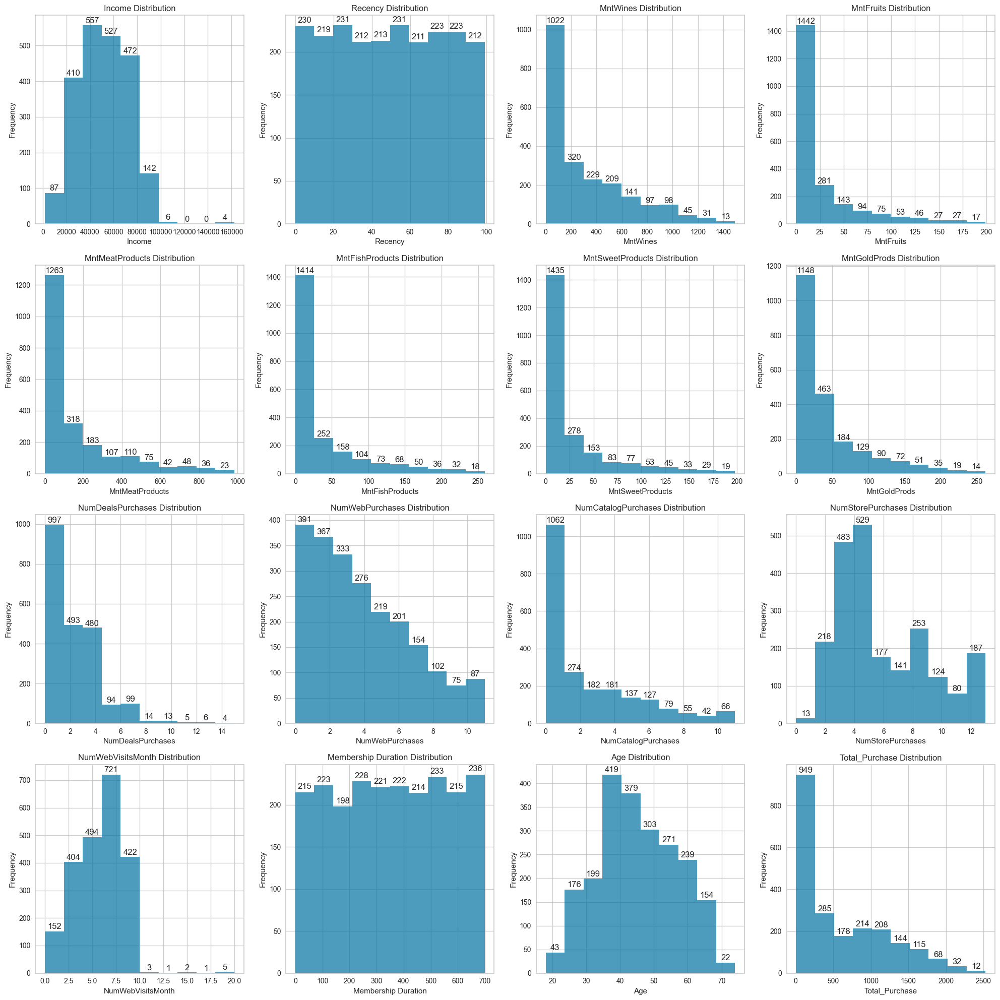

In [21]:
# Distribution of numeric columns using bar chart

# List of columns for distribution (excluding non-numeric columns)

# Calculate the number of subplot rows and columns
num_cols = 4
num_rows = (len(numeric_col) + num_cols - 1) // num_cols

# Create subplots for each column
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(20, 5*num_rows))

# Plot histograms for each column
for i, column in enumerate(numeric_col):
    row = i // num_cols
    col = i % num_cols
    data_clean[column].plot(kind='hist', ax=axes[row, col], alpha=0.7)
    axes[row, col].set_title(column + ' Distribution')
    axes[row, col].set_xlabel(column)
    axes[row, col].set_ylabel('Frequency')
    
    # Annotate bars with the count of values
    for rect in axes[row, col].patches:
        height = rect.get_height()
        axes[row, col].text(rect.get_x() + rect.get_width()/2, height + 2, f'{int(height)}', ha='center', va='bottom')

plt.tight_layout()
plt.show()

### Distribution of Categorical Columns

The categorical columns display noticeable imbalances as indicated by the pie chart, particularly in the columns related to "acceptcmp" and "complains." This implies that the acceptance rate within the campaigns is significantly low. 

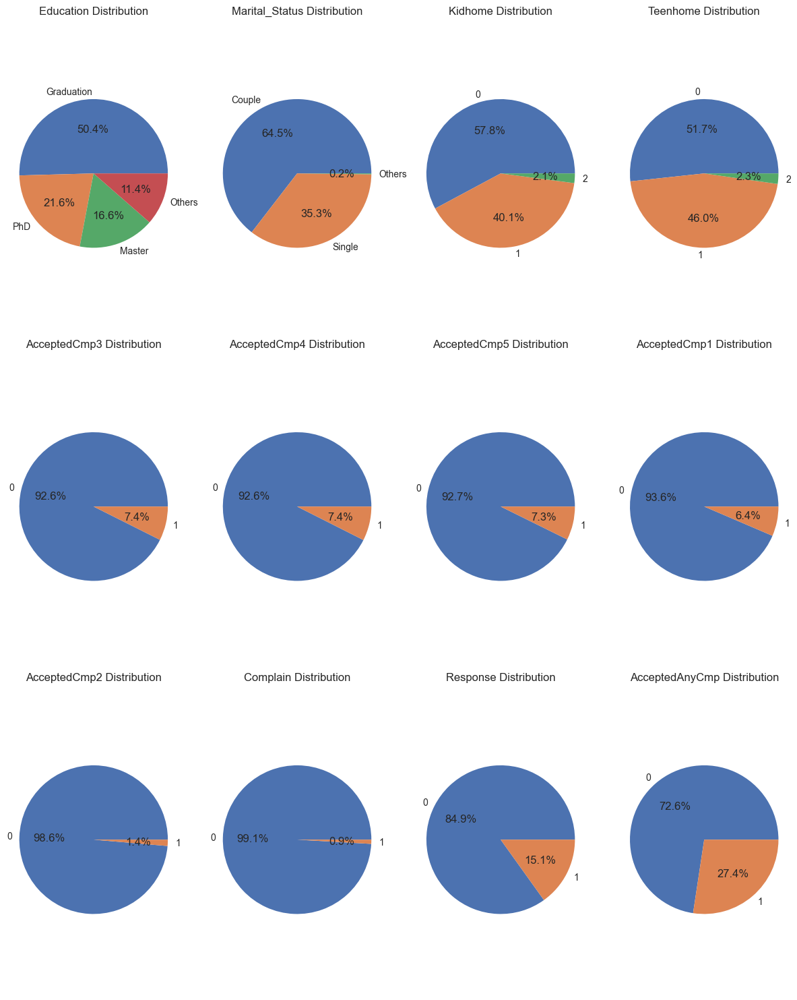

In [22]:
# Distribution of Categorical variables using pie chart

# Calculate the number of subplot rows and columns
# Set the color palette
colors = sns.color_palette("deep")

# Calculate the number of subplot rows and columns
num_cols = 4
num_rows = (len(categorical_col) + num_cols - 1) // num_cols

# Create subplots for each categorical column
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(12, 5*num_rows))

# Plot pie charts for each categorical column using Seaborn
for i, column in enumerate(categorical_col):
    row = i // num_cols
    col = i % num_cols
    data_clean[column].value_counts().plot(kind='pie', ax=axes[row, col], autopct='%1.1f%%', colors=colors)
    axes[row, col].set_title(column + ' Distribution')
    axes[row, col].set_ylabel('')
    axes[row, col].axis('equal')

plt.tight_layout()
plt.show()

In [23]:
# Perform one-hot encoding for categorical variables
data_encoded = pd.get_dummies(data_clean, columns=categorical_col)

### Correlation Matrix

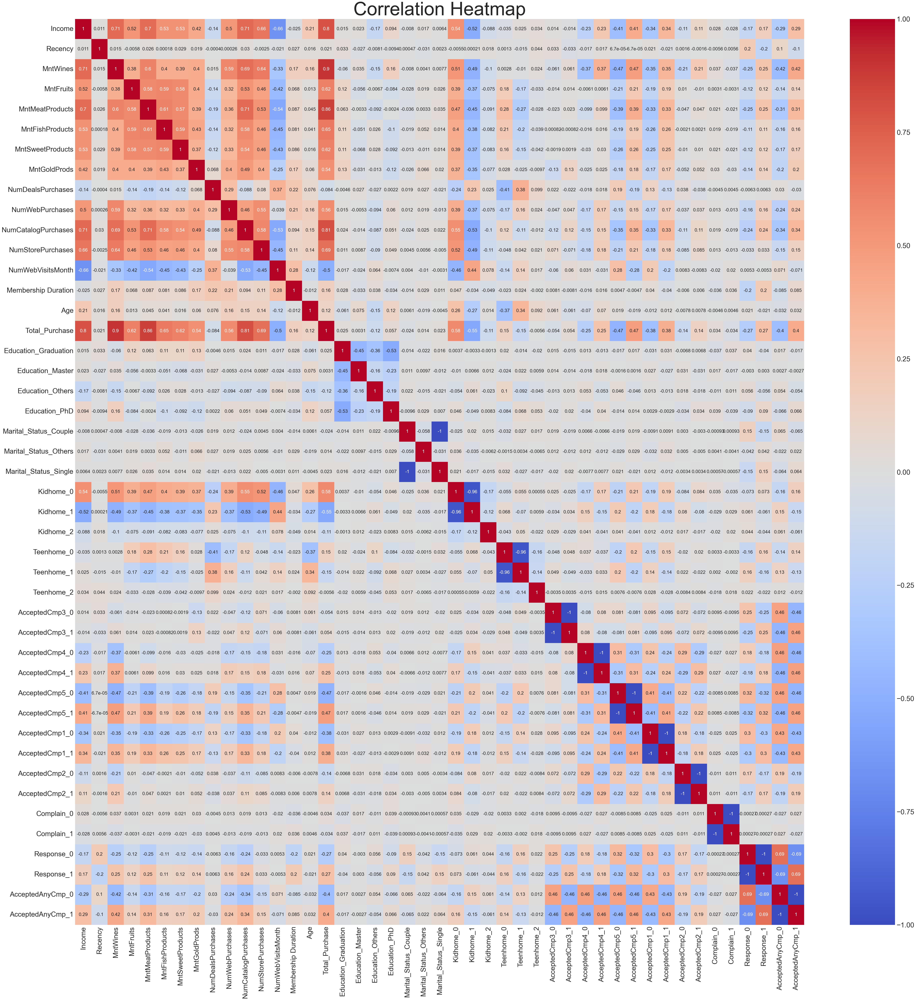

In [24]:
# Calculate the correlation matrix
correlation_matrix = data_encoded.corr()

# Create a heatmap of the correlation matrix
plt.figure(figsize=(70, 70))
heatmap = sns.heatmap(data=correlation_matrix, annot=True, cmap='coolwarm', annot_kws={'size': 20}, center=0)

# Increase x-label and y-label font size
heatmap.set_xticklabels(heatmap.get_xticklabels(), fontsize=30)
heatmap.set_yticklabels(heatmap.get_yticklabels(), fontsize=30)

# Set the title font size using fontdict
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize': 80})

# Create colorbar and adjust tick label size
colorbar = heatmap.collections[0].colorbar
colorbar.ax.tick_params(labelsize=30)

plt.show()


## Data Pre-processing

###  Data Standardization

In [25]:
# Standardize the data
data_scaled = data_encoded.copy()
colnames = data_encoded.columns
scaler = StandardScaler()
data_scaled[numeric_col] = scaler.fit_transform(data_encoded[numeric_col])
data_scaled = pd.DataFrame(data_scaled, columns = colnames)


### PCA

I have opted to utilize a cumulative explained variance plot for determining the optimal number of components. In this approach, I have set a threshold value of 0.9. According to the plot, the number of PCA components is 15.

Optimal number of components: 15


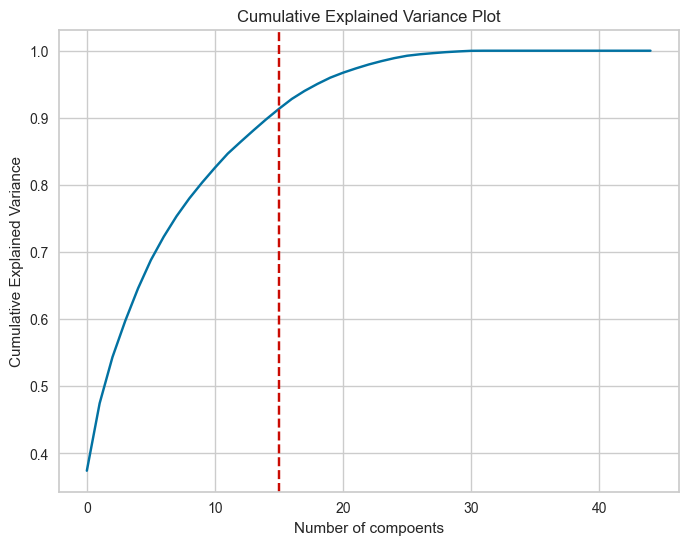

In [26]:
# PCA
pca = PCA()
data_pca = pca.fit_transform(data_scaled)
explained_variance_ratio = pca.explained_variance_ratio_

# Find the optimal number of components (features)
cumulative_explained_variance = np.cumsum(explained_variance_ratio)
optimal_components = np.argmax(cumulative_explained_variance >= 0.9)
print("Optimal number of components:", optimal_components)


# Cumulative Explained Variance plot
plt.figure(figsize=(8,6))
plt.plot(np.cumsum(explained_variance_ratio))
plt.axvline(x=optimal_components, color='r', linestyle='--', label='Optimal Components')
plt.xlabel("Number of compoents")
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance Plot')
plt.show()

In [27]:
# use pca to transform the data using the optimal number of components.
pca = PCA(n_components = optimal_components)
data_pca = pca.fit_transform(data_scaled)


## Models


### KMeans Clustering

Firstly, before implementing the KMeans clustering, we need to determine the number of clusters required. In this project, I will utilize the Elbow Method to identify the optimal number of clusters. And the optimal number of clusters is 4 according to the plot.

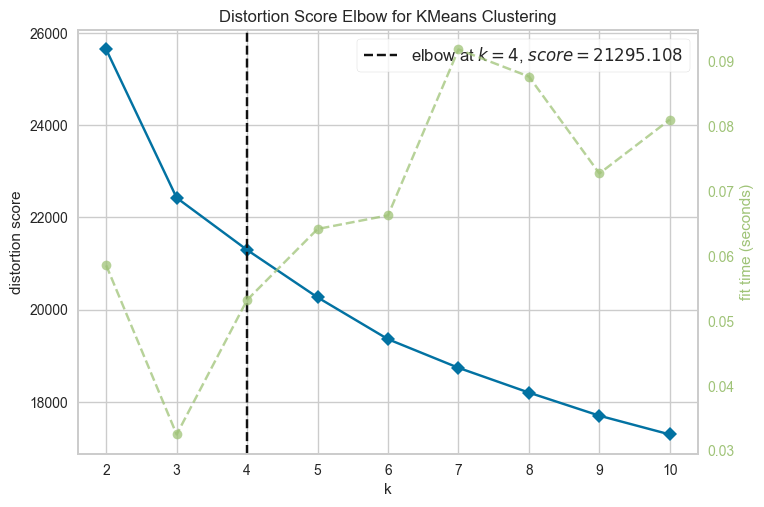

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [28]:
# choose the opitmal number of cluters using elbow method.

elbow = KElbowVisualizer(KMeans(random_state=0), k=10)
elbow.fit(data_pca)
elbow.show()

In [29]:
n_clusters = 4
# Clustering using K-means Clustering
kmeans = KMeans(n_clusters=n_clusters,random_state=0)
clusters = kmeans.fit_predict(data_pca)


### Agglomerative Hierarchical Clustering

We will employ the same number, which is 4, for performing clustering using hierarchical clustering. And draw the dendrogram to show the results.

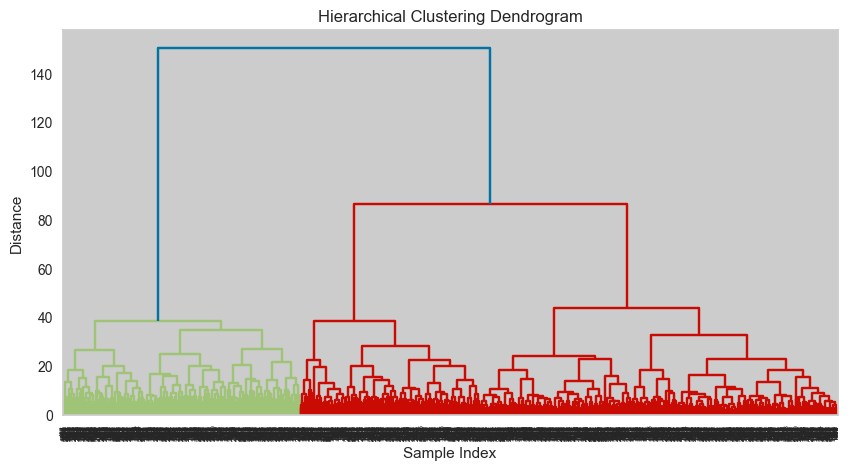

In [30]:
agg_clustering = AgglomerativeClustering(n_clusters=n_clusters)
clusters_agg = agg_clustering.fit_predict(data_pca)

#plot the dendrogram
Z = linkage(data_scaled, method='ward')
plt.figure(figsize=(10, 5))
dendrogram(Z)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel('Distance')
plt.show()

## Model Comparison

Conduct a comparison between the two models based on three metrics: silhouette score, Davies-Bouldin Index, and Calinski-Harabasz Index.

In [31]:
# silhouette score

# print out the silhouette score for the kmeans model
silhouette_kmeans = silhouette_score(data_encoded, clusters)
formatted_score = format(silhouette_kmeans, ".4f")
print("The silhouette score for the KMeans model is:", formatted_score)

# print out the silhouette score for the hierarchical clustering model
silhouette_agg = silhouette_score(data_encoded, clusters_agg)
formatted_score_agg = format(silhouette_agg, ".4f")
print("The silhouette score for the hierarchical clustering model is:", formatted_score_agg)


The silhouette score for the KMeans model is: 0.1612
The silhouette score for the hierarchical clustering model is: 0.1318


In [32]:
# Davies-Bouldin Index
davies_bouldin_kmeans = davies_bouldin_score(data_encoded, clusters)
print("Davies-Bouldin Index for the KMeans model: ", davies_bouldin_kmeans)

davies_bouldin_agg = davies_bouldin_score(data_encoded, clusters_agg)
print("Davies-Bouldin Index for the hierarchical clustering model: ", davies_bouldin_agg)

Davies-Bouldin Index for the KMeans model:  1.1832455181536436
Davies-Bouldin Index for the hierarchical clustering model:  1.3531102214232467


In [33]:
# Calinski-Harabasz Index
calinski_harabasz_kmeans = calinski_harabasz_score(data_encoded, clusters)
print("Calinski-Harabasz Index for the KMeans model: ", calinski_harabasz_kmeans)

calinski_harabasz_agg = calinski_harabasz_score(data_encoded, clusters_agg)
print("Calinski-Harabasz Index for the hierarchical clustering model: ", calinski_harabasz_agg)


Calinski-Harabasz Index for the KMeans model:  1772.0377756853945
Calinski-Harabasz Index for the hierarchical clustering model:  1522.1751561170831


In [34]:
from prettytable import PrettyTable

# Create a PrettyTable
table = PrettyTable()
table.field_names = ["Metric", "KMeans", "Hierarchical"]

# Add rows with results
table.add_row(["Silhouette Score", f"{silhouette_kmeans:.4f}", f"{silhouette_agg:.4f}"])
table.add_row(["Davies-Bouldin Index", f"{davies_bouldin_kmeans:.4f}", f"{davies_bouldin_agg:.4f}"])
table.add_row(["Calinski-Harabasz Index", f"{calinski_harabasz_kmeans:.4f}", f"{calinski_harabasz_agg:.4f}"])

print(table)



+-------------------------+-----------+--------------+
|          Metric         |   KMeans  | Hierarchical |
+-------------------------+-----------+--------------+
|     Silhouette Score    |   0.1612  |    0.1318    |
|   Davies-Bouldin Index  |   1.1832  |    1.3531    |
| Calinski-Harabasz Index | 1772.0378 |  1522.1752   |
+-------------------------+-----------+--------------+


Based on three metrics: silhouette score, Davies-Bouldin Index, and Calinski-Harabasz Index, KMeans clustering performs better than hierarchical clustering.

## Model Optimization

Since the silhouette score is currently low, we will attempt to enhance its value by applying the search grid method for optimization. This approach aims to fine-tune the clustering parameters in order to achieve an improved silhouette score.

In [35]:
# Define a function to calculate silhouette score
def silhouette_scorer(estimator, X):
    labels = estimator.fit_predict(X)
    return silhouette_score(X, labels)

# Define the parameter distributions
param_dist = {
    'n_clusters': [n_clusters],
    'init': ['k-means++', 'random'],
    #'max_iter': randint(100, 501),
    'tol': [1e-4, 1e-3, 1e-2]
}

# Create a KMeans instance
kmeans = KMeans(n_clusters,random_state=0)

# Use RandomizedSearchCV with custom scoring function
random_search = RandomizedSearchCV(kmeans, param_distributions=param_dist, n_iter=10, cv=5, scoring=silhouette_scorer)
random_search.fit(data_pca)

# Get the best hyperparameters and score
best_params = random_search.best_params_
best_score = random_search.best_score_

print("Best Hyperparameters:", best_params)

# Perform K-means clustering with the best hyperparameters
final_kmeans = KMeans(**best_params, random_state=0)
final_clusters = final_kmeans.fit_predict(data_pca)


Best Hyperparameters: {'tol': 0.0001, 'n_clusters': 4, 'init': 'random'}


In [36]:
silhouette_kmeans_opt = silhouette_score(data_encoded, final_clusters)
formatted_score_opt = format(silhouette_kmeans_opt, ".4f")
print("The silhouette score for the optimal KMeans model is:", formatted_score_opt)


The silhouette score for the optimal KMeans model is: 0.1619


## Clusters Exploration

In [37]:
# add the cluster labels to dataset
data_clean["Cluster"] = final_clusters

In [38]:
# The distribution of customer numbers in each cluster

labels = ['Cluster 0', 'Cluster 1', 'Cluster 2','Cluster 3']
values = [data_clean[data_clean['Cluster'] == i].shape[0] for i in range(4)]

fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=0.3, title='Clusters')])
fig.show()

Upon completion of the clustering process, the dataset is divided into four clusters, each of which boasts a roughly equivalent size distribution.

In [39]:
# 3D PCA plot of clusters: choose the first 3 PCA features

pca_3d = pd.DataFrame(data_pca[:, :3].copy())
pca_3d.columns = ['PCA1', 'PCA2', 'PCA3']
pca_3d["Cluster"] = final_clusters

fig = px.scatter_3d(pca_3d, x='PCA1', y='PCA2', z='PCA3', color='Cluster', 
                    color_discrete_sequence=px.colors.qualitative.Set1,
                    opacity=0.7,
                    title='3D PCA Plot of Clusters')
fig.update_layout(scene=dict(xaxis_title='PCA1', yaxis_title='PCA2', zaxis_title='PCA3'))
fig.update_traces(marker=dict(size=5)) 
fig.show()


We have opted to visualize the clusters using 3D and 2D principal components (PCAs). From the plots, it is evident that the four clusters are distinctively separated, indicating successful clustering.

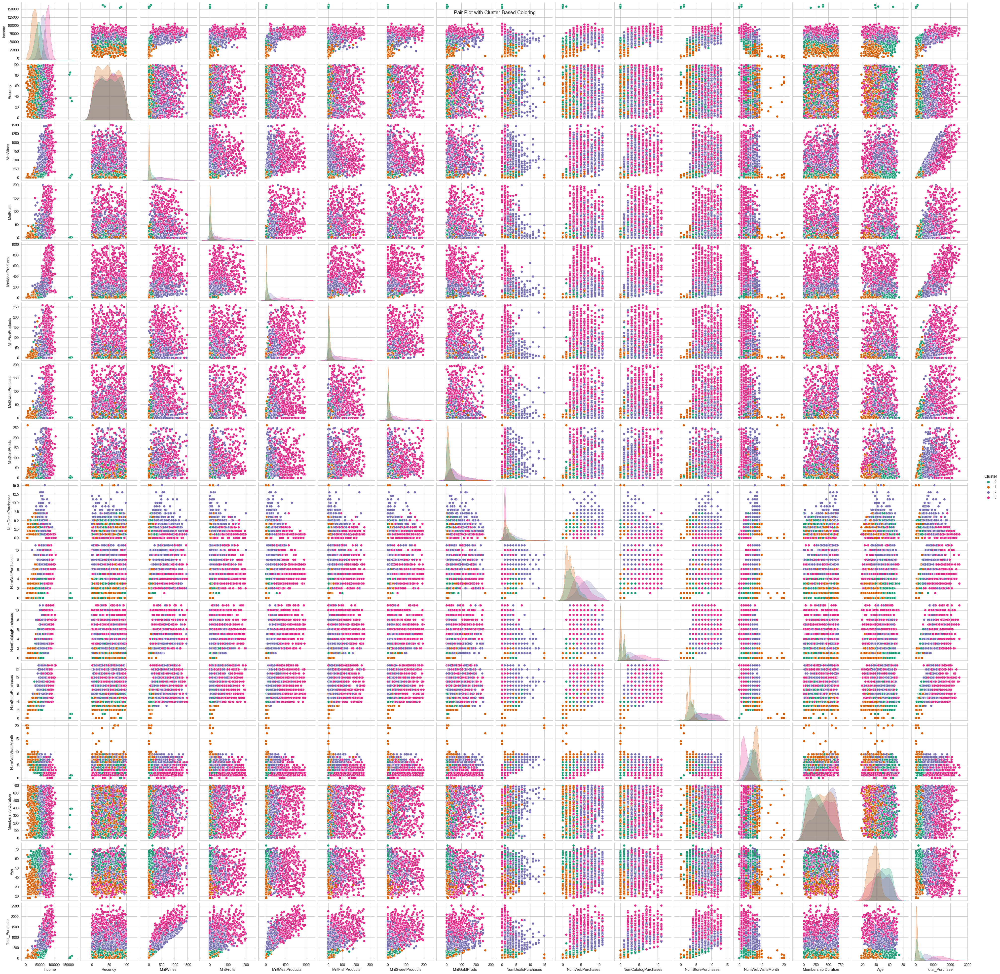

In [41]:
# Create a pair plot with cluster-based coloring
sns.pairplot(data_clean, hue='Cluster', palette='Dark2')
plt.suptitle("Pair Plot with Cluster-Based Coloring")
plt.show()

Based on this pairplot, the most significant difference among clusters is from the Income vs Total_Purchase. It seems to be the linear relationship showing that a higher income corresponds to increased spending behavior.

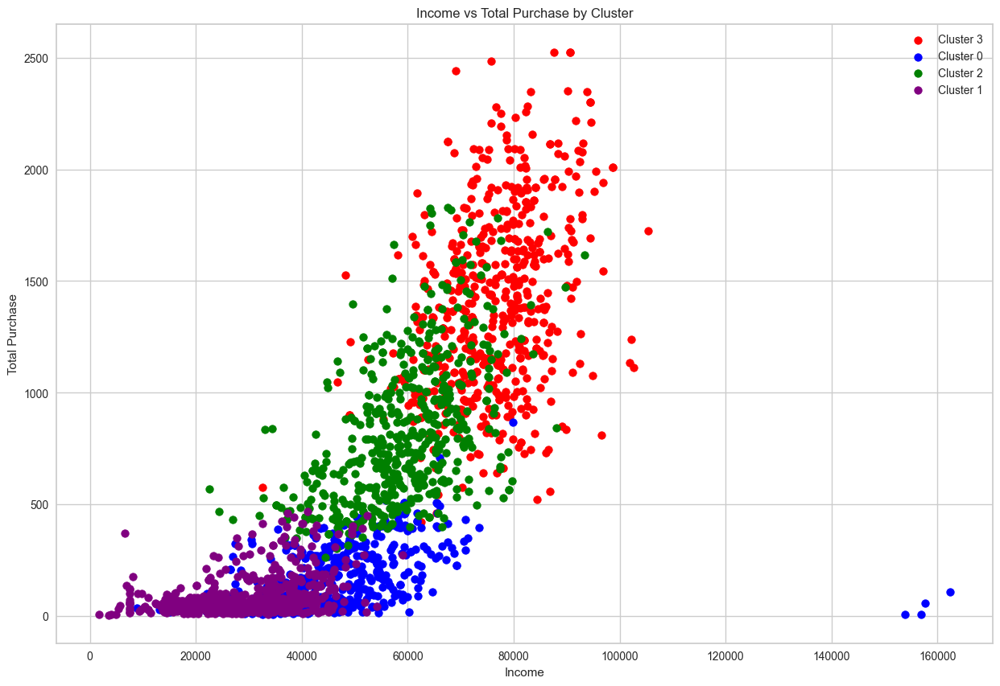

In [42]:
# Income vs Total_Purchase
# Define the colors for each cluster (you can choose your own colors)
cluster_colors = ['red', 'blue', 'green', 'purple']

# Get unique cluster labels
unique_clusters = data_clean['Cluster'].unique()

# Create subplots for each cluster
plt.figure(figsize=(15, 10))

for cluster_label, color in zip(unique_clusters, cluster_colors):
    cluster_data = data_clean[data_clean['Cluster'] == cluster_label]
    
    plt.scatter(cluster_data['Income'], cluster_data['Total_Purchase'], color=color, label=f'Cluster {cluster_label}', s=50)

plt.xlabel('Income')
plt.ylabel('Total Purchase')
plt.title('Income vs Total Purchase by Cluster')
plt.legend()
plt.show()


As we see from the plot above, we can figure out some characters among each of clusters. 
- cluster 0: medium income, low purchase amount
- cluster 1: low income, low purchase amount
- cluster 2: medium income, medium or high purchase amount
- cluster 3: high income, high purchase amount

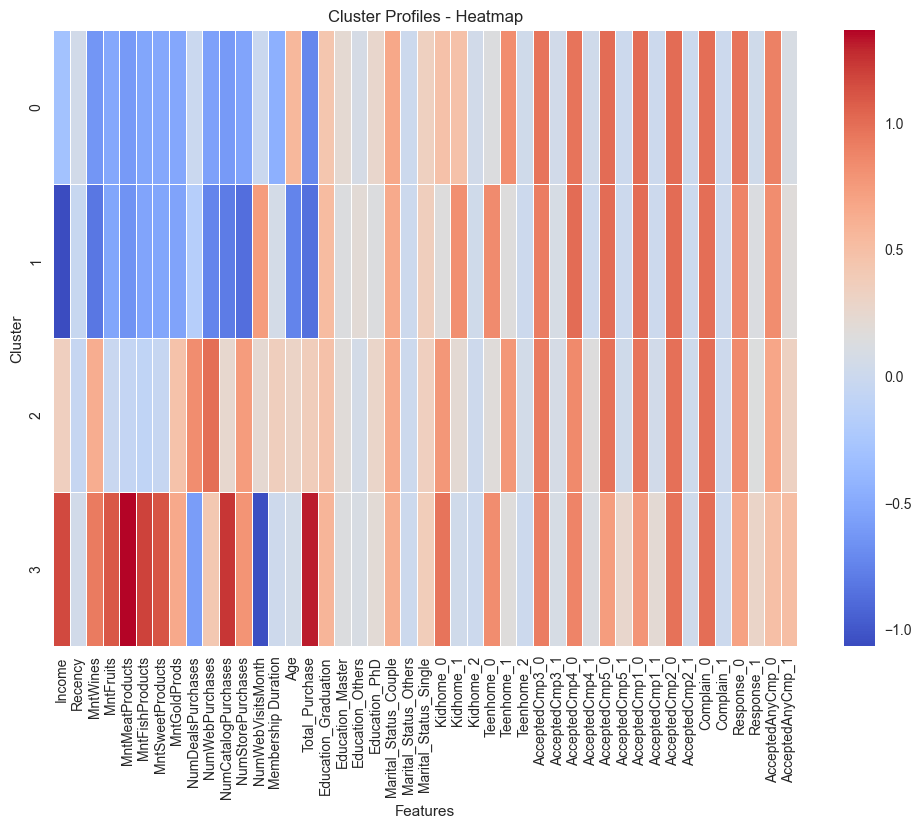

In [43]:
# heatmap to show the mean difference among clusters

df = data_scaled.copy()
df["cluster"] = final_clusters

# Calculate the cluster profiles (mean values of features for each cluster)
cluster_profiles = df.groupby('cluster').mean()

# Create a heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(cluster_profiles, cmap='coolwarm', annot=False, fmt=".2f", linewidths=.5)
plt.title('Cluster Profiles - Heatmap')
plt.xlabel('Features')
plt.ylabel('Cluster')
plt.show()


The heatmap shows the main differences among clusters are included in the numerica features.

In [44]:
num_cluster = pd.concat([data_clean[numeric_col], data_clean['Cluster']],axis=1)
cluster_profiles = num_cluster.groupby('Cluster').mean()
cluster_profiles

,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Membership Duration,Age,Total_Purchase
Cluster,,,,,,,,,,,,,,,,
0,45497.834630,50.266537,92.743191,6.233463,34.546693,8.673152,6.186770,17.101167,2.278210,2.595331,0.959144,4.089494,5.309339,262.725681,51.608949,165.484436
1,29385.885852,48.049839,29.480707,5.454984,23.130225,8.339228,5.599678,15.967846,2.003215,2.123794,0.456592,2.993569,7.141479,365.774920,36.295820,87.972669
2,59123.128846,47.875000,520.246154,25.546154,151.659615,32.980769,25.319231,67.748077,3.867308,6.682692,3.309615,8.226923,5.894231,426.296154,48.534615,823.500000
3,76360.672131,50.158470,616.723133,69.819672,458.581056,102.832423,72.355191,77.579235,1.218579,5.169399,6.021858,8.378871,2.788707,356.843352,45.688525,1397.890710


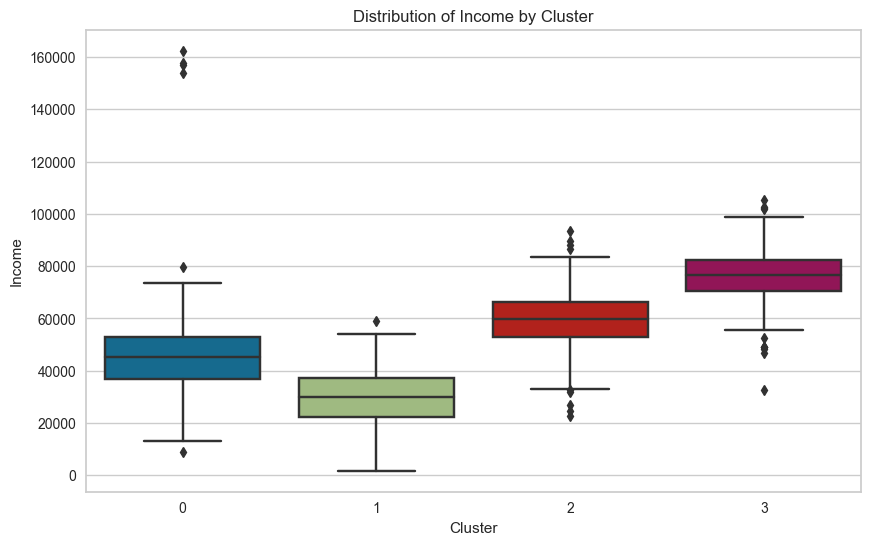

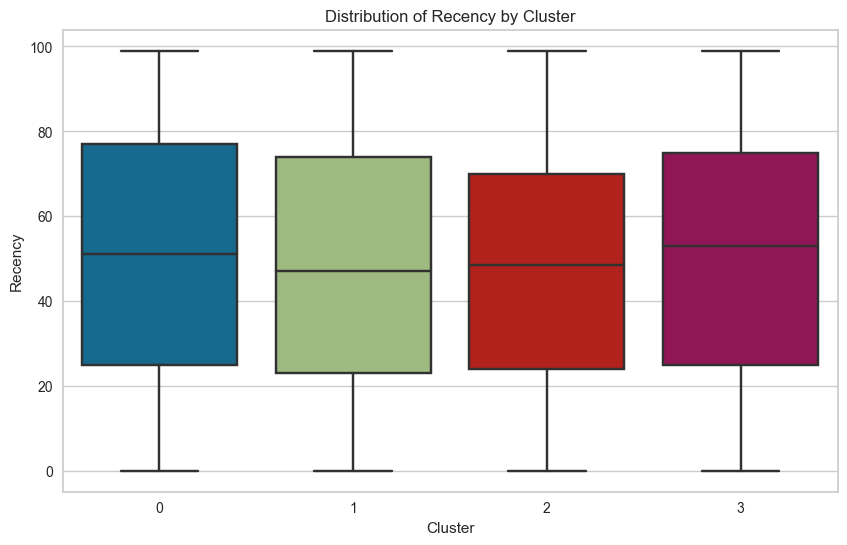

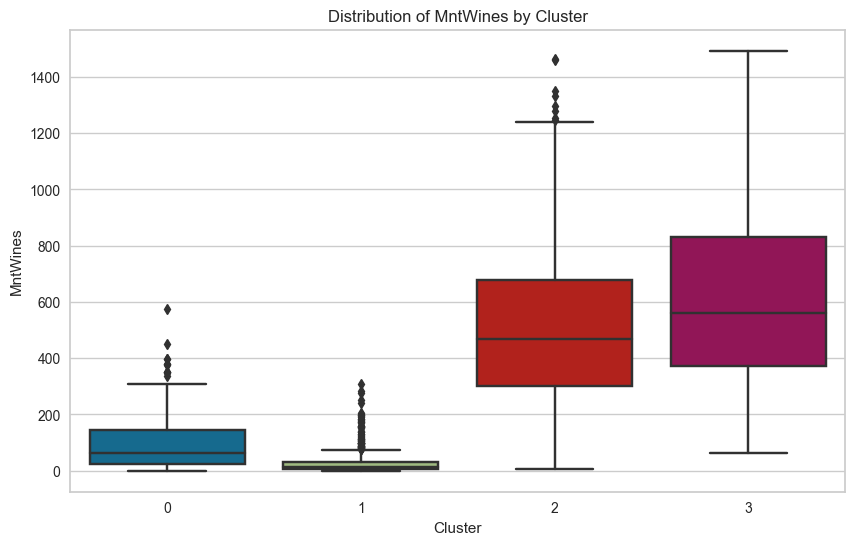

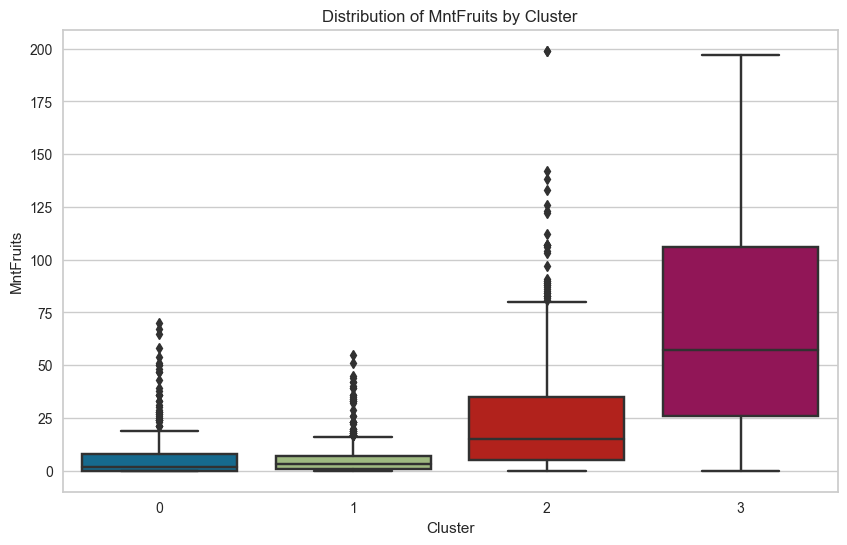

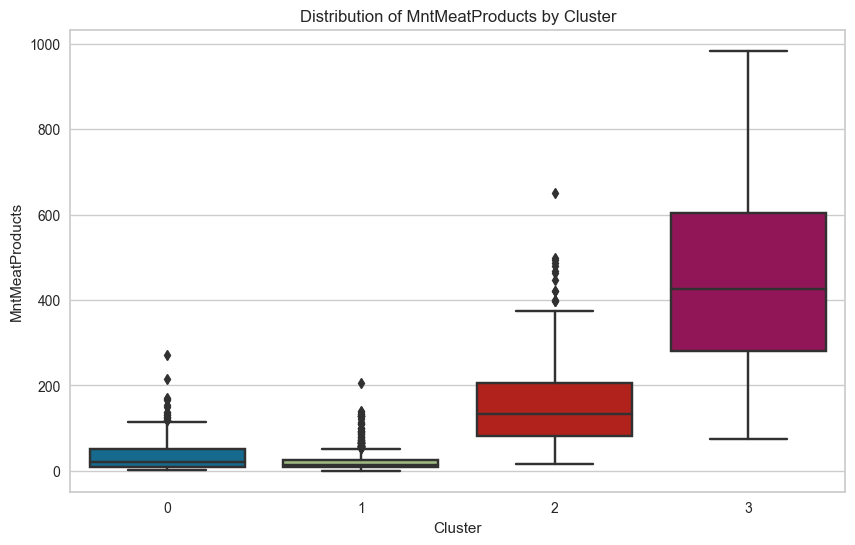

...

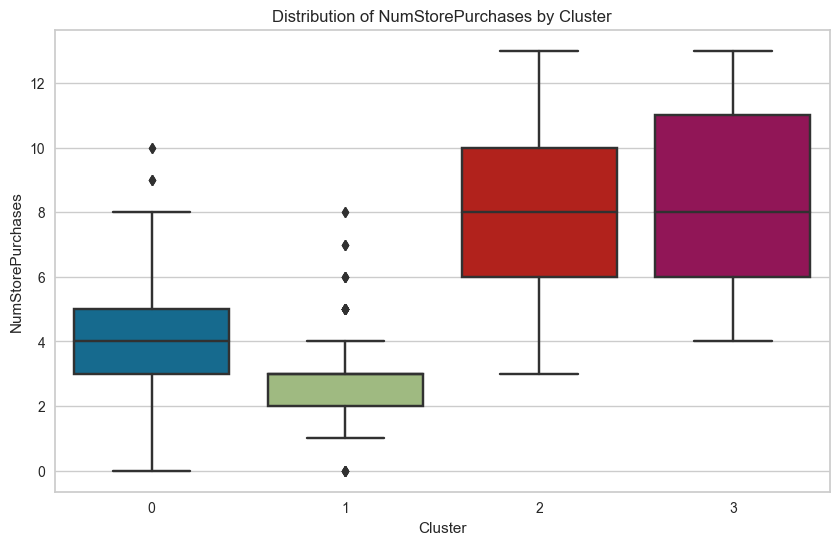

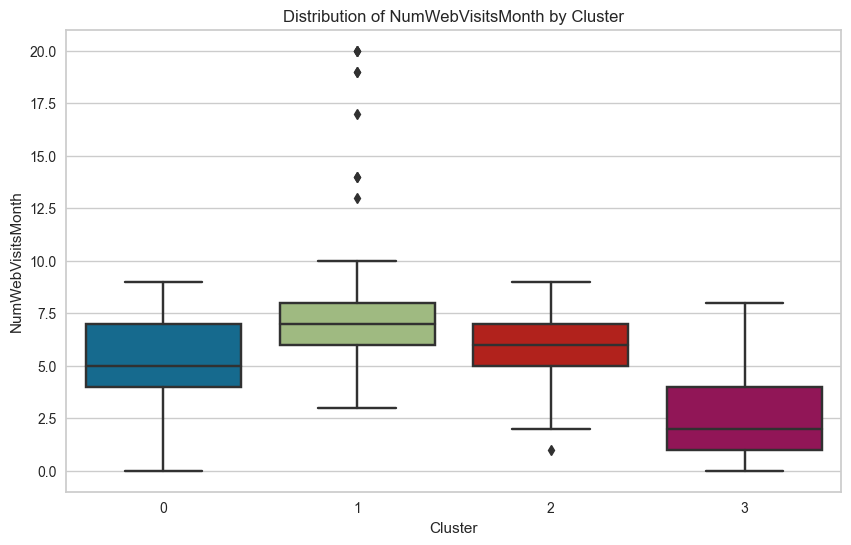

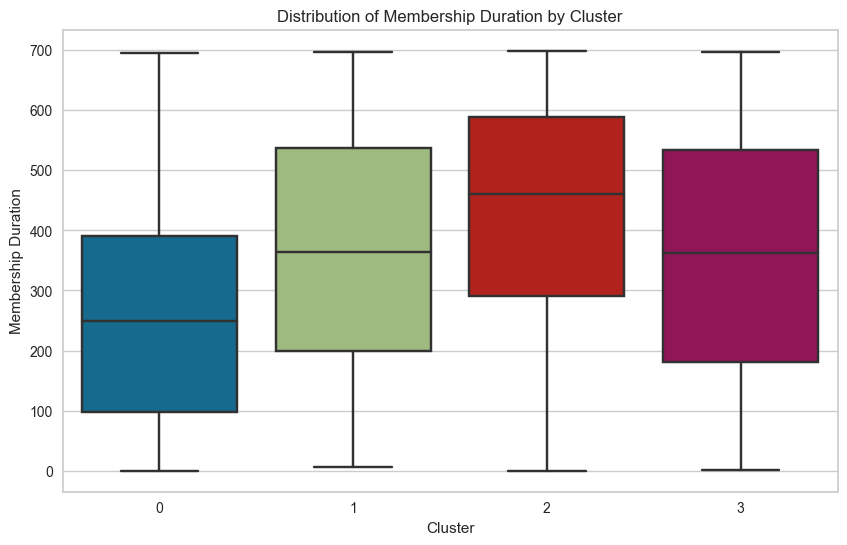

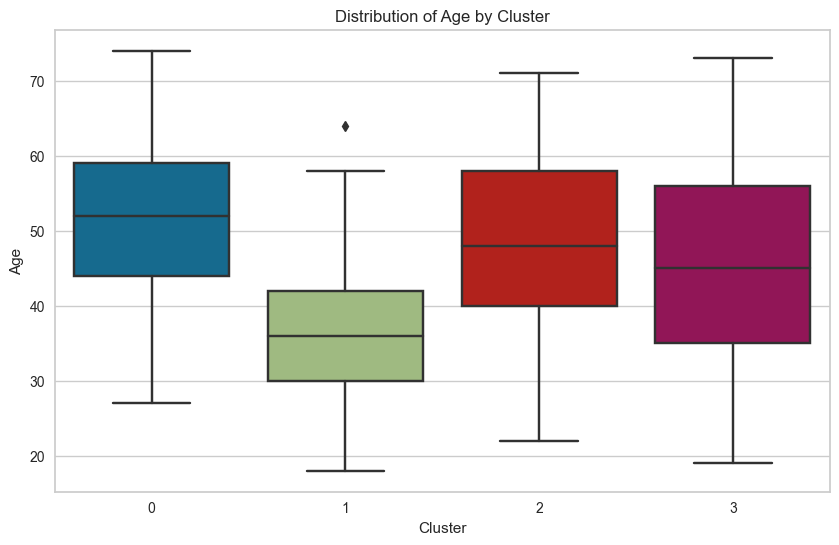

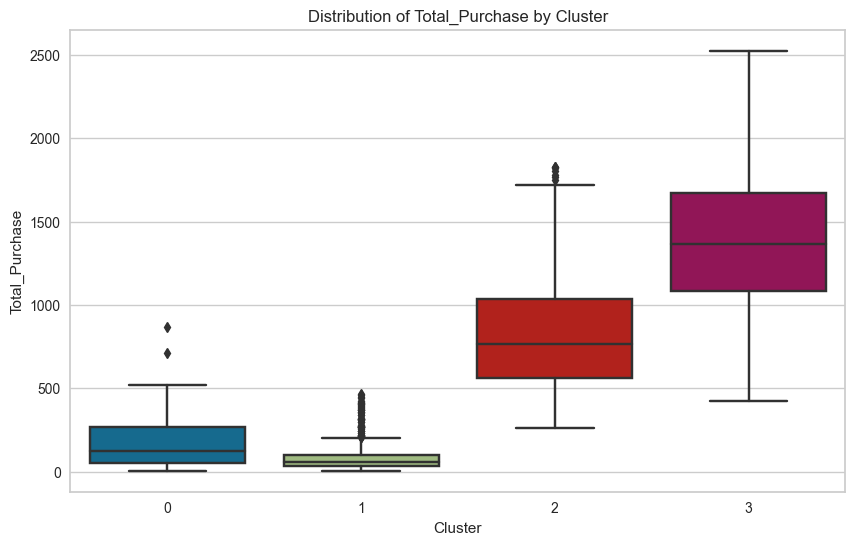

In [45]:
# Distribution of numeric features in each cluster

for column in numeric_col:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='Cluster', y=column, data=data_clean)
    plt.title(f'Distribution of {column} by Cluster')
    plt.xlabel('Cluster')
    plt.ylabel(column)
    plt.show()

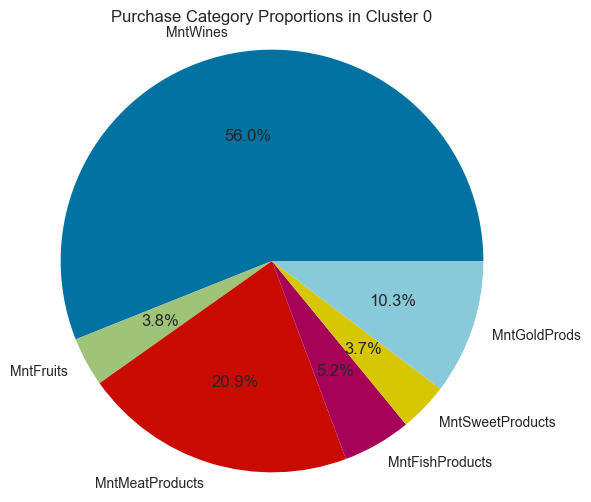

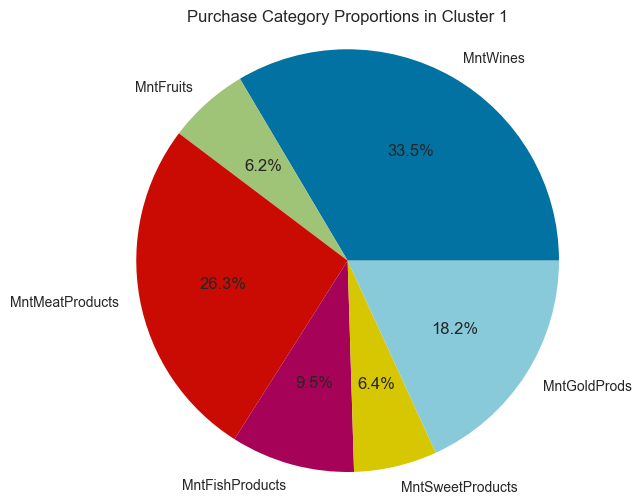

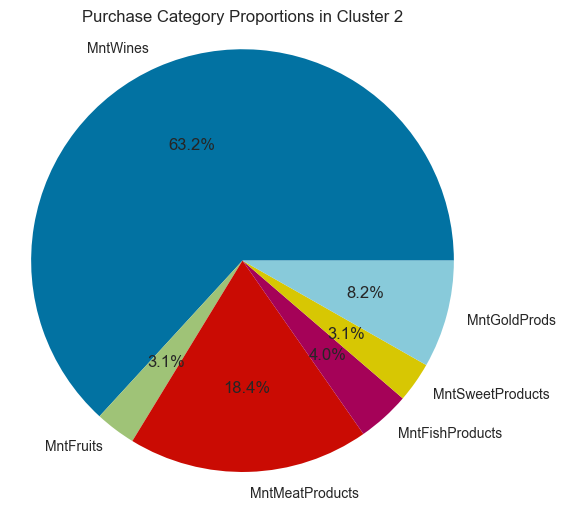

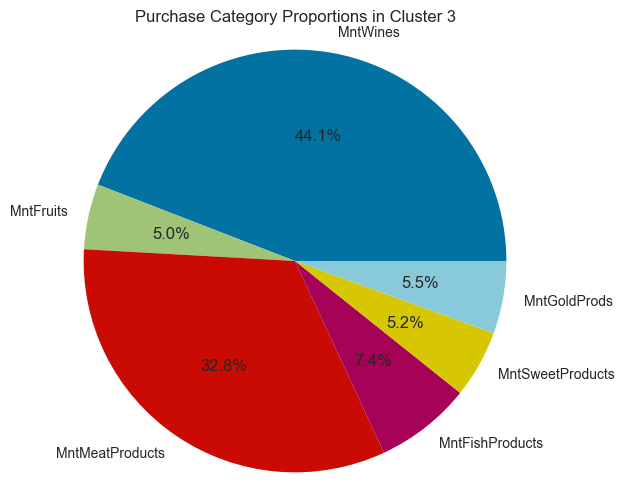

In [46]:
# Purchase category proportion

purchase_columns = ['MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts', 'MntGoldProds']
cluster_means = data_clean.groupby('Cluster')[purchase_columns].mean()
cluster_proportions = cluster_means.divide(data_clean.groupby('Cluster')["Total_Purchase"].mean(), axis='index')

# Plot pie charts for each cluster
for cluster_id in cluster_proportions.index:
    plt.figure(figsize=(6, 6))
    plt.pie(cluster_proportions.loc[cluster_id], labels=purchase_columns, autopct='%1.1f%%')
    plt.title(f'Purchase Category Proportions in Cluster {cluster_id}')
    plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    plt.show()

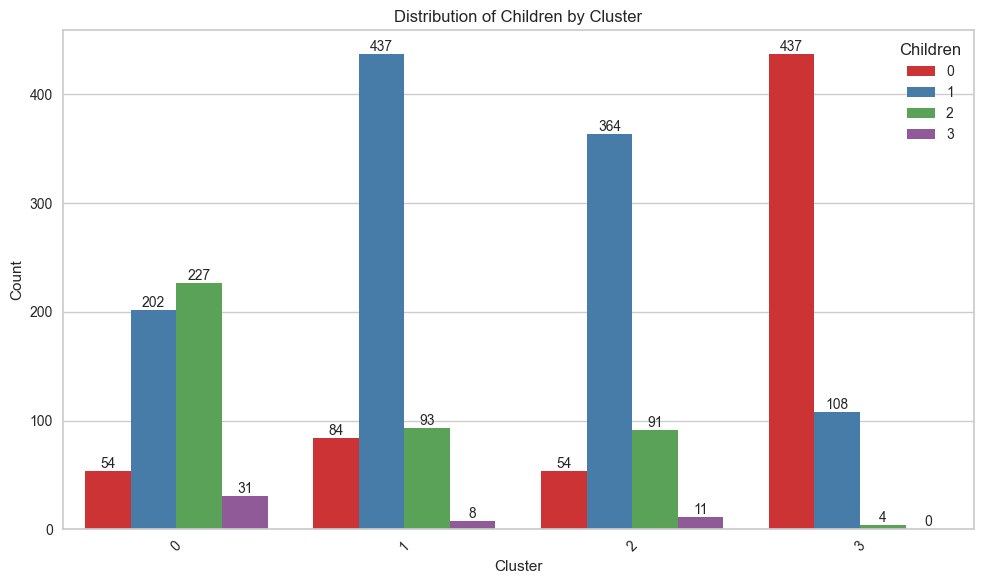

In [47]:
# Number of children

# Calculate the sum of Kidhome and Teenhome columns for each cluster
df_children = data_clean.copy()
df_children['children'] = data_clean['Kidhome'].astype(int) + data_clean['Teenhome'].astype(int)

# Create a figure with a single subplot
plt.figure(figsize=(10, 6))

# Plot the countplot for the combined home status
sns.countplot(data=df_children, x='Cluster', hue='children', palette='Set1')

# Add labels to the bars
for p in plt.gca().patches:
    height = p.get_height()
    plt.gca().annotate(f'{int(height)}', (p.get_x() + p.get_width() / 2., height),
                       ha='center', va='bottom', fontsize=10)

# Set title, labels, and legend
plt.title(f'Distribution of Children by Cluster')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.legend(title='Children')

# Adjust x-axis tick labels rotation
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


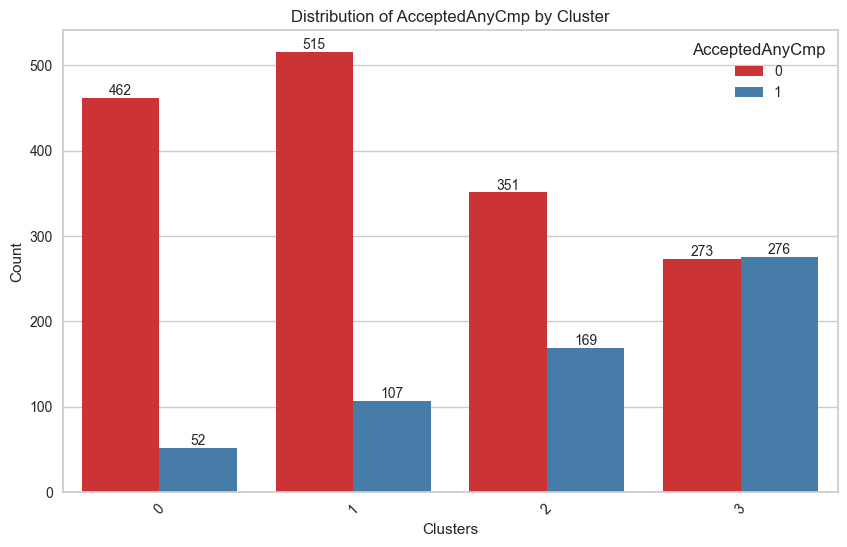

In [48]:
# accept any offer in the campaigns

plt.figure(figsize=(10, 6))
sns.countplot(data=data_clean, x='Cluster', hue='AcceptedAnyCmp', palette='Set1')

# Add labels to the bars
for p in plt.gca().patches:
    height = p.get_height()
    plt.gca().annotate(f'{int(height)}', (p.get_x() + p.get_width() / 2., height),
                       ha='center', va='bottom', fontsize=10)

plt.title(f'Distribution of AcceptedAnyCmp by Cluster')
plt.xlabel('Clusters')
plt.ylabel('Count')
plt.legend(title='AcceptedAnyCmp')
plt.xticks(rotation=45)
plt.show()

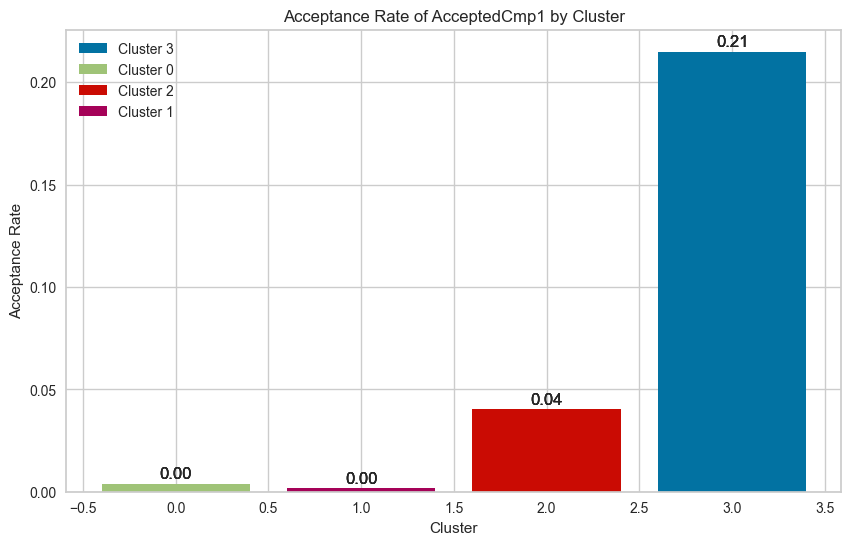

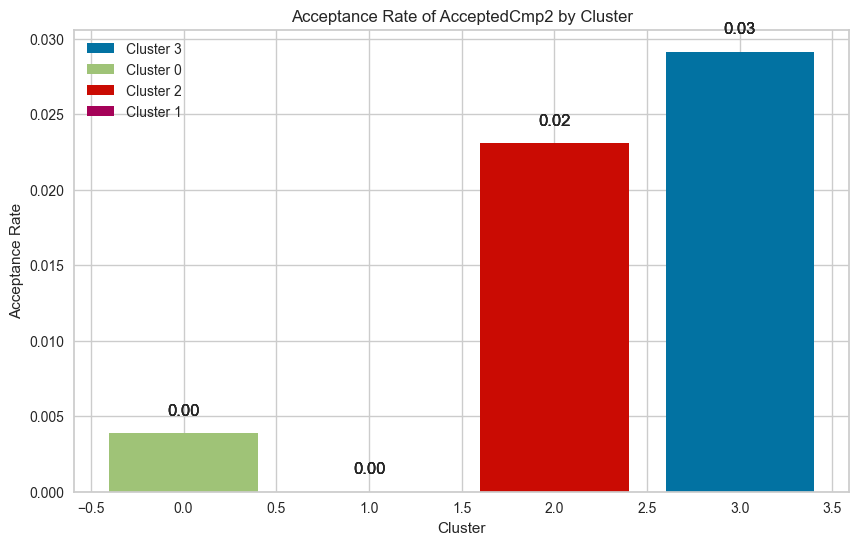

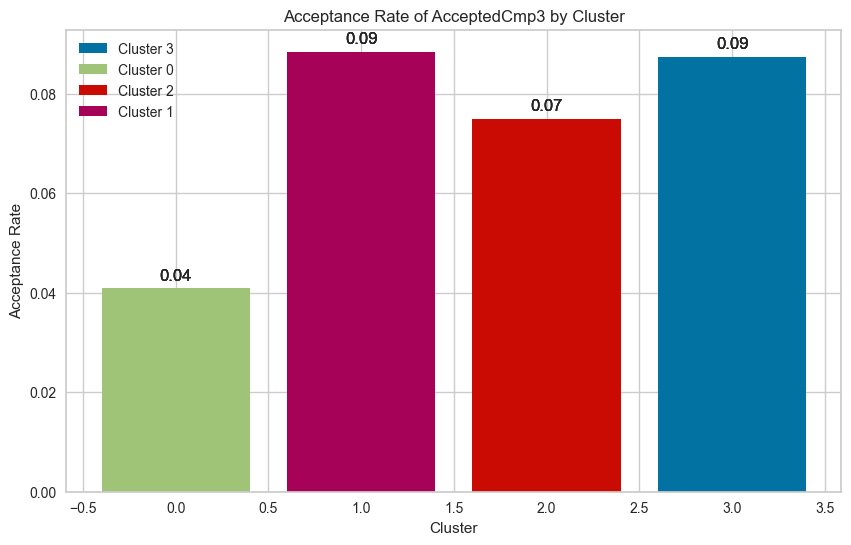

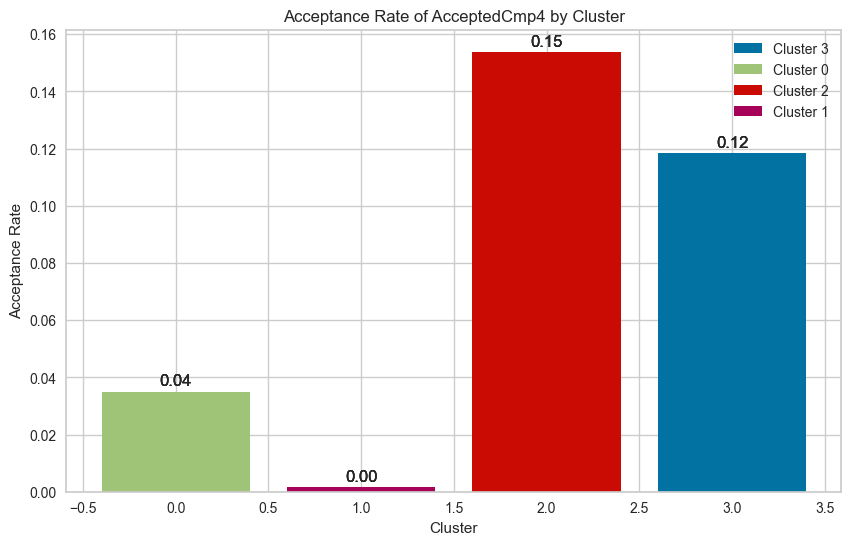

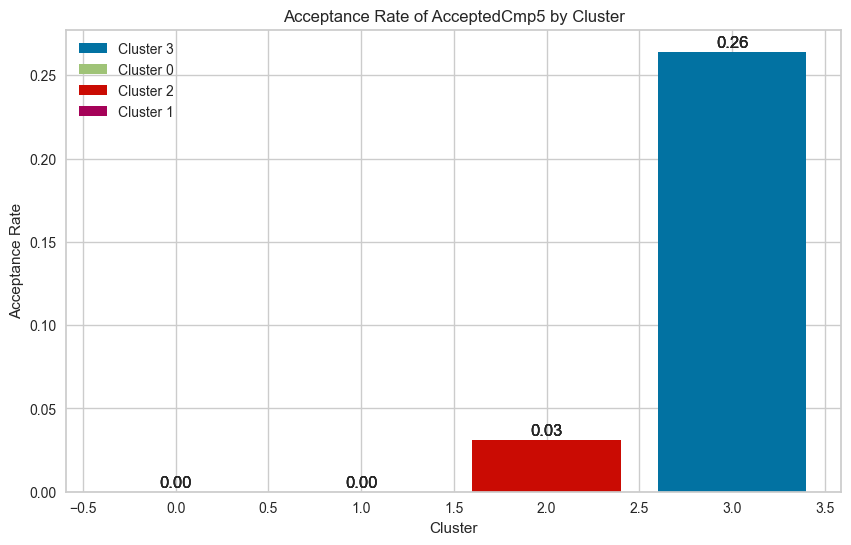

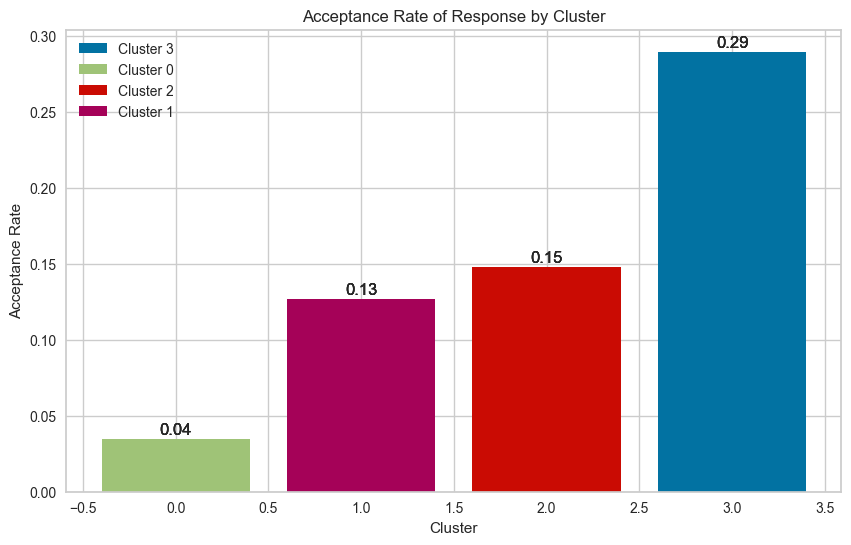

In [49]:
# accept rates in each campaign of each clusters

campaign_cols = ['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5','Response']

# Calculate acceptance rate for each campaign in each cluster
acceptance_rates = {}
unique_clusters = data_clean['Cluster'].unique()
for cluster in unique_clusters:
    cluster_data = data_clean[data_clean['Cluster'] == cluster]
    acceptance_rates[cluster] = {}
    for campaign in campaign_cols:
        acceptance_rate = cluster_data[campaign].astype(int).mean()
        acceptance_rates[cluster][campaign] = acceptance_rate

# Plot acceptance rates for each campaign in each cluster
for campaign in campaign_cols:
    plt.figure(figsize=(10, 6))
    for cluster in unique_clusters:
        plt.bar(cluster, acceptance_rates[cluster][campaign], label=f'Cluster {cluster}')

        # Add labels on top of each bar
        for cluster in unique_clusters:
            plt.text(cluster, acceptance_rates[cluster][campaign] + 0.001, f'{acceptance_rates[cluster][campaign]:.2f}', ha='center', va='bottom')

    plt.title(f'Acceptance Rate of {campaign} by Cluster')
    plt.xlabel('Cluster')
    plt.ylabel('Acceptance Rate')
    plt.legend()
    plt.show()


## Conclusion

Delving deeper into cluster exploration, we analyzed how each cluster differed across various features. Here is a brief summary of each cluster based on the feature characteristics. This insight offers strategic direction for targeted marketing efforts.

- Cluster 0: 

    - medium income, low purchase amount
    
    - relatively senior customer with the mean age 51
    
    - majority of customers are parents
    
    
- Cluster 1: 

    - low income, low purchase amount
    
    - Relatively young customer with the mean age 36
    
    - majority of customers are parents
    
    - larger number of webvisits, but low number of purchase
    
    - interested in gold purchase
    
    
    
    
- Cluster 2: 

    - medium income, medium or high purchase amount
    
    - The highest proportion of wines purchase amount with average 63.2%
    
    - lower catalog purchase compare to other options
    
    
- Cluster 3: 

    - high income, high purchase amount
    
    - most customers do not have children
    
    - willing to accept the offers
    
    - prefer make purchase in store compared to online purchase
    
    - less use deals
   

## Challenges

The silhouette score has been improved to 0.1619, although it still remains relatively modest. This could potentially be attributed to the existence of notable noise or limited information within the dataset, posing challenges to the clustering process. To further enhance our analysis, we could explore alternative advanced dimension reduction techniques and experiment with different clustering models in pursuit of achieving more favorable outcomes.